In [1]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from tqdm.notebook import tqdm as tqdm

Função Objetivo

In [2]:
#domain [0, 10]
def F11(x, y):
    m = 5
    a = [3,5,2,1,7]
    b = [5,2,1,4,9]
    c = [1,2,5,2,3]

    result = 0

    for i in range(1, m+1):
        result += c[i-1] * np.exp( (-np.square(x - a[i-1]) / np.pi) - np.square(y - b[i-1])/np.pi) * np.cos(np.pi * np.square(x - a[i-1]) + np.pi * np.square(x - b[i-1]))
        
    return result

In [3]:
F11(1,1)

-3.75809032616141

In [4]:
#domain [-5.12, 5.12]
def F2(x, y):
        return np.add(np.power(x, 2), np.power(y, 2))

In [5]:
#domain [0, pi]
def F12(x, y):
    x_part = np.power((np.sin(x) * np.sin((5 * x ** 2) / np.pi)), 20)
    y_part = np.power((np.sin(y) * np.sin((10 * (y ** 2)) / np.pi )), 20)

    return -np.add(x_part, y_part)

Comparando Partículas

In [6]:
def evaluate_best(x1, y1, x2, y2):
    if (x1 == None) or (y1 == None):
        return [x2, y2]
    elif (x2 == None) or (y2 == None):
        return [x1, y1]
    else:
        if F11(x1, y1) <= F11(x2, y2):
            return [x1, y1]
        else:
            return [x2, y2]

Inicializando a população

In [7]:
def create_swarm(n):
    best_particle_position = [None, None]
    swarm = []
    for i in range(n):
            #x, y, v
        particle = {
            #'x': np.random.rand() * (5.12 * 2) - 5.12,
            #'y': np.random.rand() * (5.12 * 2) - 5.12,
            'x': np.random.rand() * 10,
            'y': np.random.rand() * 10,
            'last_x': 0,
            'last_y': 0,
            'v': 0,
            'personal_best': 0,
            #melhor posição de informates (conjunto de particulas aleatorias selecionadas)
            'informant_best': [None, None]
            #melhor posição de todas as partículas
            #'best_particle': best_particle_position
        }

        particle['last_x'] = particle['x']
        particle['last_y'] = particle['y']
        particle['v'] = [(particle['x'] - particle['last_x']), (particle['y'] - particle['last_y'])]
        particle['personal_best'] = evaluate_best(particle['x'], particle['y'], particle['last_x'], particle['last_y'])
        
        swarm.append(particle)
    return swarm

Vizualizando o Problema

In [8]:
#_domain = np.linspace(-5.12, 5.12, 100)
#y_domain = np.linspace(-5.12, 5.12, 100)

#z = F2(x_domain, y_domain)

#x_domain = np.outer(np.linspace(-5.12, 5.12, 1000), np.ones(1000))
#x_domain = np.outer(np.linspace(0, np.pi, 300), np.ones(300))

x_domain = np.outer(np.linspace(0, 10, 1000), np.ones(1000))
y_domain = x_domain.copy().T
z = F11(x_domain, y_domain)

In [9]:
fig = go.Figure(data=[go.Surface(z=z)])

fig.update_layout(title='F11 - Langermanns function', autosize=False,
                  width=1000, height=800)
                  #margin=dict(l=65, r=50, b=65, t=90))

fig.show()

Loop Principal

In [15]:
swarm_length = 250
speed_proportion = 0.1
particle_information_num = 25
best_personal_proportion = 0.35
best_information_proportion = 0.2
best_particle_proportion = 0.1
speed_factor = 0.075
num_iterations = 500
swarm = create_swarm(swarm_length)

best_particle_position = [None, None]

iteration_track_best = []

for iteration in tqdm(range(num_iterations),unit="Iteration"):

    for particle in swarm:

        #Evaluate best particle
        best_particle_position = evaluate_best(particle['x'], particle['y'], best_particle_position[0], best_particle_position[1])

    iteration_track_best.append(best_particle_position)
    
    for particle in swarm:

        if (particle['informant_best'][0] == None) or (particle['informant_best'][1] == None):
            particle['informant_best'][0] = particle['personal_best'][0]
            particle['informant_best'][1] = particle['personal_best'][1]
        else:
            information_list = []
            
            for j in range(particle_information_num):
                information_list.append(swarm[np.random.randint(0, swarm_length)]['personal_best'])
            info_best = information_list[0]
            
            for k in information_list:
                info_best = evaluate_best(k[0], k[1], info_best[0], info_best[1])

            particle['informant_best'][0] = info_best[0]
            particle['informant_best'][1] = info_best[1]

            

        particle['last_x'] = particle['x']
        particle['last_y'] = particle['y']
        #particle['v'] = [(particle['x'] - particle['last_x']), (particle['y'] - particle['last_y'])]
        particle['personal_best'] = evaluate_best(particle['x'], particle['y'], particle['last_x'], particle['last_y'])

        b = np.random.rand() * best_personal_proportion
        c = np.random.rand() * best_information_proportion
        d = np.random.rand() * best_particle_proportion

        vx = (speed_proportion * particle['v'][0]) + (b * (particle['personal_best'][0] - particle['x'])) + (c * (particle['informant_best'][0] - particle['x'])) + (d * (best_particle_position[0] - particle['x']))
        vy = (speed_proportion * particle['v'][1]) + (b * (particle['personal_best'][1] - particle['y'])) + (c * (particle['informant_best'][1] - particle['y'])) + (d * (best_particle_position[1] - particle['y']))

        particle['v'] = [vx, vy]
        particle['x'] = particle['x'] + (speed_factor * particle['v'][0])
        particle['y'] = particle['y'] + (speed_factor * particle['v'][1])






  0%|          | 0/500 [00:00<?, ?Iteration/s]

Avaliação

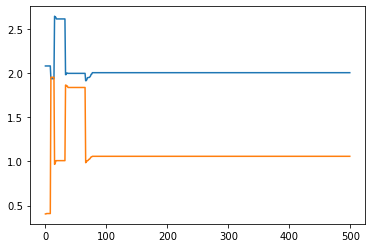

In [16]:
plt.plot(iteration_track_best);

In [17]:
print(f'Best position: {best_particle_position}')

Best position: [2.003089135073665, 1.0569344747154472]


In [18]:
best_x, best_y = best_particle_position[0], best_particle_position[1]
best_score = F11(best_x, best_y)
print(f'Best Score: {best_score}')

Best Score: -5.1671212097136685


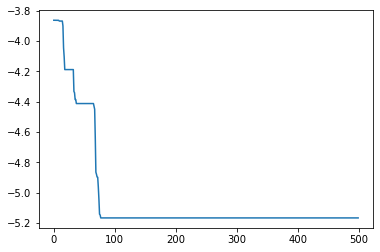

In [19]:
score_tracker = []

for track in iteration_track_best:
    score_tracker.append(F11(track[0], track[1]))
plt.plot(score_tracker);